<a href="https://colab.research.google.com/github/akielbowicz/tp-msscae-2024/blob/main/notebooks/propagaci%C3%B3n_a_un_paso.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#31/05

La función del 30/05 hace DFS, no BFS. La voy a hacer iterativo y corregirlo.

In [25]:
# import sys # Para subir el límite de recursión. (No lo usamos mas)
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import itertools as it
import pandas as pd
import queue

## defs

In [11]:
def plot(G, labels=False, grande=True, node_data=False,):
  connectionstyle = [f"arc3,rad={r}" for r in it.accumulate([0.15] * 4)]

  tamaños = list(G.degree())

  for i in range(len(tamaños)):
    tamaños[i] = (tamaños[i][1] ** 2) / 9 if ((tamaños[i][1] ** 2) / 9 ) > 100 else 100

  pos = nx.kamada_kawai_layout(G)
  if grande:
    fig, ax = plt.subplots(figsize=(30, 30))
  else:
    fig,ax = plt.subplots(figsize=(8,8))
  plt.axis("off")

  nx.draw_networkx_nodes(G, pos, node_size=tamaños, ax = ax)

  nx.draw_networkx_labels(G, pos, font_size=10, ax=ax)

  nx.draw_networkx_edges(
      G, pos, edge_color="grey", connectionstyle=connectionstyle, ax=ax, arrows=True, arrowstyle='->',
  )

  if labels:

    labels = {
        tuple(edge): f"{'w'}={round(attrs['w'],3)}"
        for *edge, attrs in G.edges(keys=True, data=True)
    }

    nx.draw_networkx_edge_labels(
        G,
        pos,
        labels,
        connectionstyle=connectionstyle,
        label_pos=0.3,
        font_color="blue",
        bbox={"alpha": 0},
        ax=ax,
    )

    labels = dict(G.nodes(data=True))
    for key in labels:
      labels[key] = labels[key]['precio']

    for key in pos:
      pos[key] = pos[key] + 0.05

    nx.draw_networkx_labels(
        G,
        pos,
        labels,
        font_size = 10,
        font_color="red",
        ax=ax,
    )

def setear_precios(G, precios):
  nx.set_node_attributes(G, precios)

def armar_grafo(dataframe, precios_random=True):
  graph = {}
  for index, row in dataframe.iterrows():
    d = {}
    for (k, v) in row.items():
      d[k] = {"w":v}
    graph[index] = d
  G_base = nx.MultiDiGraph(graph)
  G = nx.MultiDiGraph(graph)
  for (n1,n2,d) in G_base.edges(data=True):
    if d['w'] == 0:
      G.remove_edge(n1,n2)

  nodos = list(G.nodes())
  precios = {}
  for nodo in nodos:
    if precios_random:
      precios[nodo] = {'precio': int(round(np.random.rand() * 1000, 0))}
    else:
      precios[nodo] = {'precio': 100}
  setear_precios(G, precios)
  return G

## shock BFS

In [15]:
# Precondición: Definir t=0 afuera de la función para que corte la recursión.
def shock(nodo, aumento, G, dinamica = 1, es_shock = True, un_paso=False, limite = 10, verbose = False): # aumento pasado en %.
  global t
  global log
  fila = queue.Queue() #Fila de tuplas (Nodo, aumento)
  fila.put((nodo, aumento))
  t = t + 1

  while (t < limite and not fila.empty()):
    t = t + 1;
    nodo_actual, aumento_actual = fila.get()

    verb = f'Paso nº {t}. \n Aumentando un {aumento_actual}% a {nodo_actual}. \n'
    log = log + verb
    if verbose:
      print(verb)

    if es_shock: #Sólo hago el aumento acá si es el primer shock. Si no no, porque lo haría dos veces.
      precio_actual = G.nodes[nodo_actual]['precio']
      nuevo_precio = { nodo_actual : { 'precio': (precio_actual * (1 + (aumento_actual / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)
      es_shock = False

    # Actualización de pesos de los vecinos directos. Lo hago acá y no en un paso recursivo para asegurar que se actualizen todos los nodos
    # a k distancia antes de actualizar los de k+1.

    vecinos = G[nodo_actual].items()
    aumentos_a_pasar = []
    for vecino in vecinos:
      nodo_vecino = vecino[0]
      peso_arista = vecino[1][0]['w']
      precio_actual = G.nodes[nodo_vecino]['precio']
      aumento_pasado = aumento_actual * peso_arista
      nuevo_precio = {nodo_vecino : {'precio' : (precio_actual * (1 + (aumento_pasado / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)
      aumentos_a_pasar.append(aumento_pasado)

    #ahora sigue la cadena de aumentos.
    if not un_paso:
      for i, vecino in enumerate(vecinos):
        fila.put((vecino[0], aumentos_a_pasar[i]))
        # shock(vecino[0], aumentos_a_pasar[i], G, es_shock = False, limite = limite, verbose = verbose)

Paso nº 2. 
 Aumentando un 75% a luz. 

Paso nº 3. 
 Aumentando un 18.75% a chapa. 

Paso nº 4. 
 Aumentando un 7.5% a campo. 

Paso nº 5. 
 Aumentando un 13.125% a chip. 

Paso nº 6. 
 Aumentando un 2.8125% a comida. 

Paso nº 7. 
 Aumentando un 6.0% a comida. 



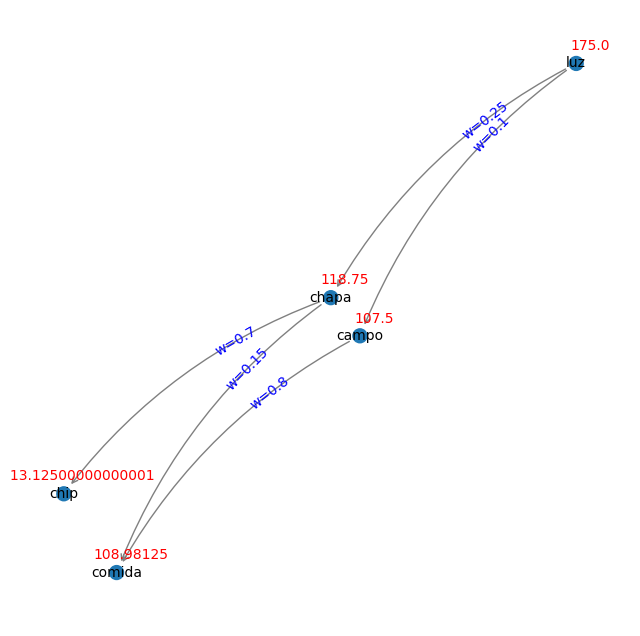

In [18]:
sectores = ['luz','chapa','campo','chip','comida']

pesos = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0,0,0,0,0],[0,0,0,0,0]])
test = pd.DataFrame(data=pesos,columns=sectores,index=sectores)

pesos_ciclo = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0.2,0,0,0,0],[0,0,0,0,0]])
test_ciclo = pd.DataFrame(data=pesos_ciclo,columns=sectores,index=sectores)
g_test = armar_grafo(test, precios_random=False)
g_test_ciclo = armar_grafo(test_ciclo, precios_random=False)

t=0
log = ""
shock('luz',75,g_test, limite=50, verbose = True)
plot(g_test, grande=False, labels=True)

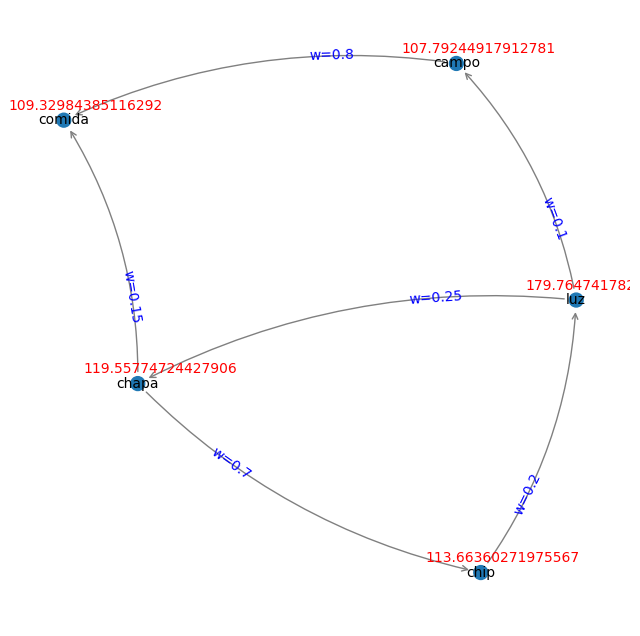

In [17]:
t=0
shock('luz',75,g_test_ciclo, limite=500)
plot(g_test_ciclo, grande=False, labels=True)

ampo. 
Paso nº 1986. 
 Aumentando un 5.344880253905625% a chip. 
Paso nº 1987. 
 Aumentando un 5.487610567348789% a comida. 
Paso nº 1988. 
 Aumentando un 2.1498961699143235% a luz. 
Paso nº 1989. 
 Aumentando un 3.143312477701507% a chapa. 
Paso nº 1990. 
 Aumentando un 3.7031898363063793% a campo. 
Paso nº 1991. 
 Aumentando un 2.082612283225213% a chip. 
Paso nº 1992. 
 Aumentando un 3.8218547615615894% a comida. 
Paso nº 1993. 
 Aumentando un 0.2837635046781255% a luz. 
Paso nº 1994. 
 Aumentando un 0.33358435600629066% a chapa. 
Paso nº 1995. 
 Aumentando un 0.13087268193026957% a campo. 
Paso nº 1996. 
 Aumentando un 0.16630603325406818% a chip. 
Paso nº 1997. 
 Aumentando un 0.23018499328611416% a comida. 
Paso nº 1998. 
 Aumentando un 4.944388062267936% a luz. 
Paso nº 1999. 
 Aumentando un 4.702110305006348% a chapa. 
Paso nº 2000. 
 Aumentando un 0.29636834802271333% a campo. 



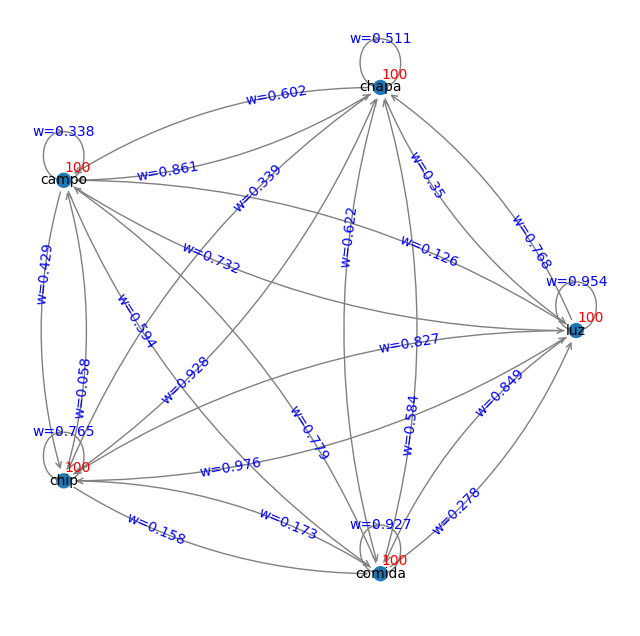

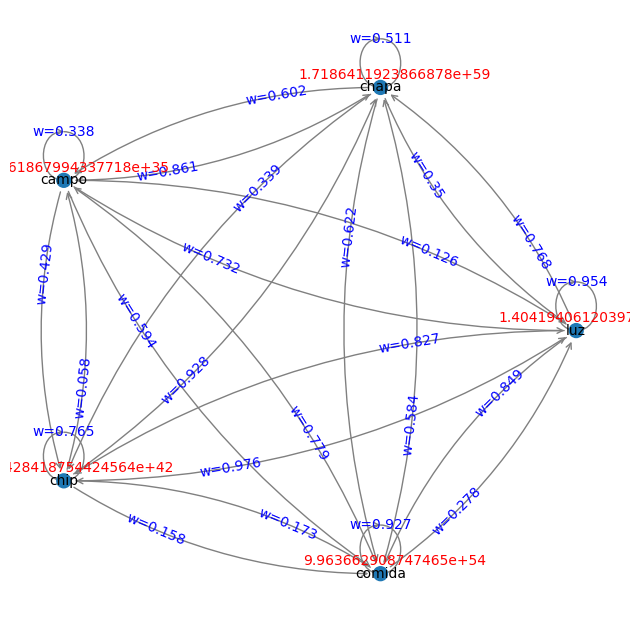

In [24]:
rng = np.random.default_rng(seed=41)
pesos = rng.random((5,5))
test_random = pd.DataFrame(data = pesos, columns = sectores, index= sectores)
test_random
g_test_random = armar_grafo(test_random, precios_random=False)
plot(g_test_random, grande=False, labels=True)
t=0
log=""
shock('luz',80,g_test_random, limite=2000)
plot(g_test_random, grande=False, labels=True)
print(log[-900:])

Armando la función bien (con BFS), parece que no converge o por lo menos no tan rapidamente. Tiene sentido por que los aumentos se propagan de una forma mas intuitiva

# 30/05

## Informe

Funciones:
* Plot: Plotea grafos. No sirve para uno de las dimensiones del MIP.
* armar_grafo
* setear_precios
* shock

In [ ]:
import sys # Para subir el límite de recursión.
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
# import itertools as it
import pandas as pd

In [ ]:
def plot(G, labels=False, grande=True, node_data=False,):
  connectionstyle = [f"arc3,rad={r}" for r in it.accumulate([0.15] * 4)]

  tamaños = list(G.degree())

  for i in range(len(tamaños)):
    tamaños[i] = (tamaños[i][1] ** 2) / 9 if ((tamaños[i][1] ** 2) / 9 ) > 100 else 100

  pos = nx.kamada_kawai_layout(G)
  if grande:
    fig, ax = plt.subplots(figsize=(30, 30))
  else:
    fig,ax = plt.subplots(figsize=(8,8))
  plt.axis("off")

  nx.draw_networkx_nodes(G, pos, node_size=tamaños, ax = ax)

  nx.draw_networkx_labels(G, pos, font_size=10, ax=ax)

  nx.draw_networkx_edges(
      G, pos, edge_color="grey", connectionstyle=connectionstyle, ax=ax, arrows=True, arrowstyle='->',
  )

  if labels:

    labels = {
        tuple(edge): f"{'w'}={round(attrs['w'],3)}"
        for *edge, attrs in G.edges(keys=True, data=True)
    }

    nx.draw_networkx_edge_labels(
        G,
        pos,
        labels,
        connectionstyle=connectionstyle,
        label_pos=0.3,
        font_color="blue",
        bbox={"alpha": 0},
        ax=ax,
    )

    labels = dict(G.nodes(data=True))
    for key in labels:
      labels[key] = labels[key]['precio']

    for key in pos:
      pos[key] = pos[key] + 0.05

    nx.draw_networkx_labels(
        G,
        pos,
        labels,
        font_size = 10,
        font_color="red",
        ax=ax,
    )

In [ ]:
def setear_precios(G, precios):
  nx.set_node_attributes(G, precios)

def armar_grafo(dataframe, precios_random=True):
  graph = {}
  for index, row in dataframe.iterrows():
    d = {}
    for (k, v) in row.items():
      d[k] = {"w":v}
    graph[index] = d
  G_base = nx.MultiDiGraph(graph)
  G = nx.MultiDiGraph(graph)
  for (n1,n2,d) in G_base.edges(data=True):
    if d['w'] == 0:
      G.remove_edge(n1,n2)

  nodos = list(G.nodes())
  precios = {}
  for nodo in nodos:
    if precios_random:
      precios[nodo] = {'precio': int(round(np.random.rand() * 1000, 0))}
    else:
      precios[nodo] = {'precio': 100}
  setear_precios(G, precios)
  return G

In [ ]:
# Precondición: Definir t=0 afuera de la función para que corte la recursión.
def shock(nodo, aumento, G, dinamica = 1, es_shock = True, un_paso=False, limite = 10, verbose = False): # aumento pasado en %.
  global t
  global log
  t = t + 1

  if t < limite:

    verb = f'Paso nº {t}. \n Aumentando un {aumento}% a {nodo}. \n'
    log = log + verb
    if verbose:

      print(verb)

    if es_shock: #Sólo hago el aumento acá si es el primer shock. Si no no, porque lo haría dos veces.
      precio_actual = G.nodes[nodo]['precio']
      nuevo_precio = { nodo : { 'precio': (precio_actual * (1 + (aumento / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)

    # Actualización de pesos de los vecinos directos. Lo hago acá y no en un paso recursivo para asegurar que se actualizen todos los nodos
    # a k distancia antes de actualizar los de k+1.
    vecinos = G[nodo].items()
    aumentos_a_pasar = []
    for vecino in vecinos:
      nodo_vecino = vecino[0]
      peso_arista = vecino[1][0]['w']
      precio_actual = G.nodes[nodo_vecino]['precio']
      aumento_pasado = aumento * peso_arista
      nuevo_precio = {nodo_vecino : {'precio' : (precio_actual * (1 + (aumento_pasado / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)
      aumentos_a_pasar.append(aumento_pasado)

    #ahora sigue la cadena de aumentos.
    if not un_paso:
      for i, vecino in enumerate(vecinos):
        shock(vecino[0], aumentos_a_pasar[i], G, es_shock = False, limite = limite, verbose = verbose)

In [ ]:
sectores = ['luz','chapa','campo','chip','comida']

pesos = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0,0,0,0,0],[0,0,0,0,0]])
test = pd.DataFrame(data=pesos,columns=sectores,index=sectores)

pesos_ciclo = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0.2,0,0,0,0],[0,0,0,0,0]])
test_ciclo = pd.DataFrame(data=pesos_ciclo,columns=sectores,index=sectores)

In [ ]:
g_test = armar_grafo(test, precios_random=False)
g_test_ciclo = armar_grafo(test_ciclo, precios_random=False)

## Shock acíclico
Antes y después de un shock a Luz con un aumento del 75% en el grafo acíclico

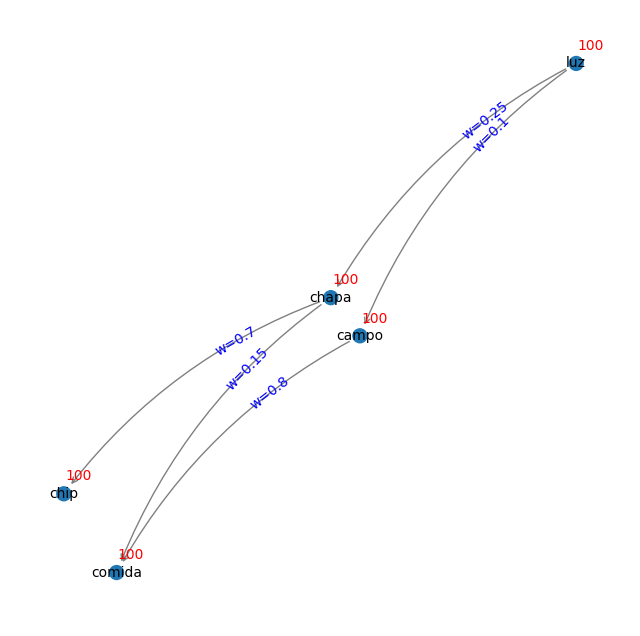

In [ ]:
plot(g_test, grande=False, labels=True)

Paso nº 1. 
 Aumentando un 75% a luz. 

Paso nº 2. 
 Aumentando un 18.75% a chapa. 

Paso nº 3. 
 Aumentando un 13.125% a chip. 

Paso nº 4. 
 Aumentando un 2.8125% a comida. 

Paso nº 5. 
 Aumentando un 7.5% a campo. 

Paso nº 6. 
 Aumentando un 6.0% a comida. 



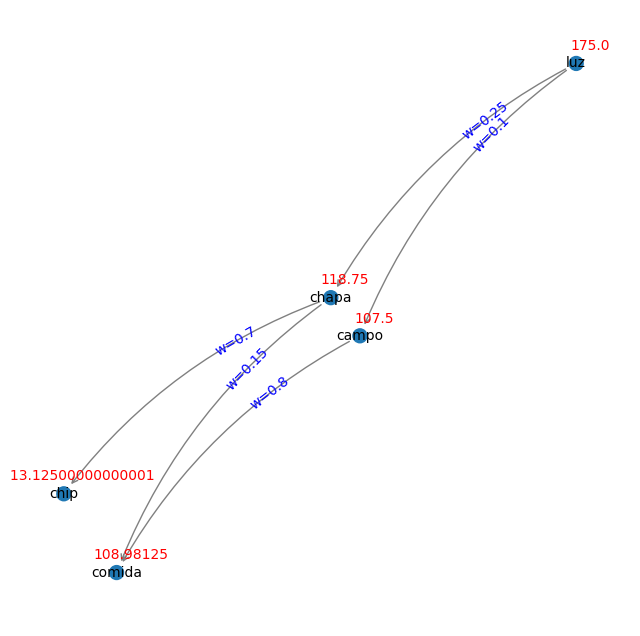

In [ ]:
t=0
log = ""
shock('luz',75,g_test, limite=50, verbose = True)
plot(g_test, grande=False, labels=True)

## Shock con ciclo

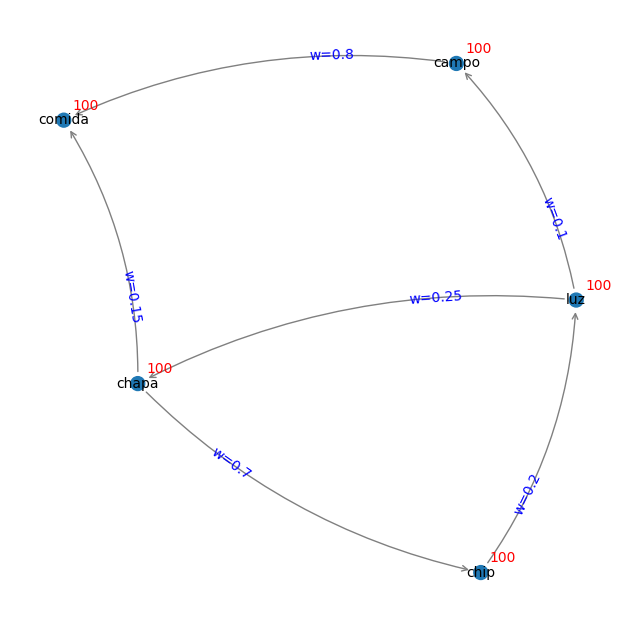

In [ ]:
plot(g_test_ciclo, grande=False, labels=True)

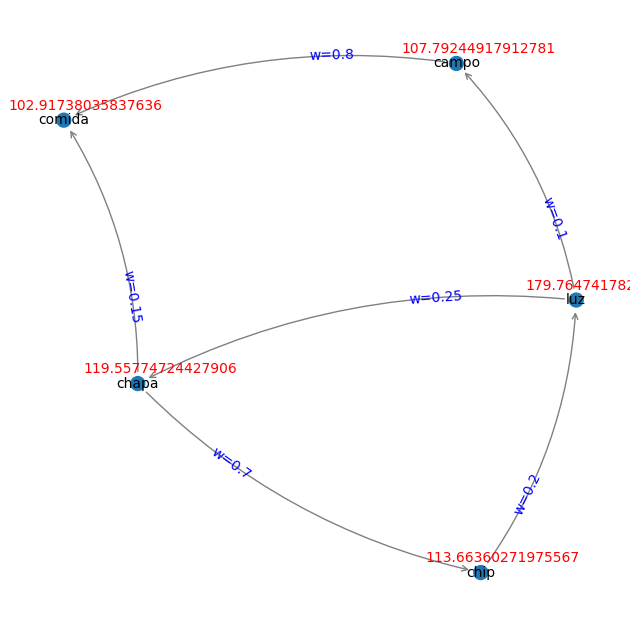

In [ ]:
t=0
shock('luz',75,g_test_ciclo, limite=50)
plot(g_test_ciclo, grande=False, labels=True)

## Observación.

Por la arista de Chip a Luz, el precio del producto que produce Luz pasó de 175 a 179.
La retroalimentación existe; este sistema **converge**?

## Convergencia o divergencia del sistema.

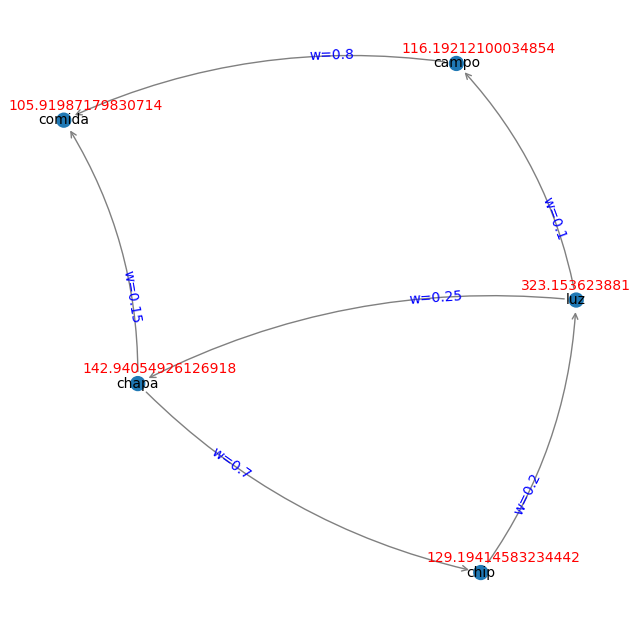

In [ ]:
sys.setrecursionlimit(2500)

t=0
log = ""
shock('luz',75,g_test_ciclo, limite=2400)
plot(g_test_ciclo, grande=False, labels=True)

In [ ]:
print(log[-600:])

Aumentando un 0.0% a luz. 
Paso nº 2387. 
 Aumentando un 0.0% a chapa. 
Paso nº 2388. 
 Aumentando un 0.0% a chip. 
Paso nº 2389. 
 Aumentando un 0.0% a luz. 
Paso nº 2390. 
 Aumentando un 0.0% a chapa. 
Paso nº 2391. 
 Aumentando un 0.0% a chip. 
Paso nº 2392. 
 Aumentando un 0.0% a luz. 
Paso nº 2393. 
 Aumentando un 0.0% a chapa. 
Paso nº 2394. 
 Aumentando un 0.0% a chip. 
Paso nº 2395. 
 Aumentando un 0.0% a luz. 
Paso nº 2396. 
 Aumentando un 0.0% a chapa. 
Paso nº 2397. 
 Aumentando un 0.0% a chip. 
Paso nº 2398. 
 Aumentando un 0.0% a luz. 
Paso nº 2399. 
 Aumentando un 0.0% a chapa. 



Podemos ver que aunque exista un ciclo de retroalimentación en la cadena productiva, por la estructura de la misma el aumento decae y el sistema termina practicamente convergiendo a un estado de equilibrio

In [ ]:
rng = np.random.default_rng(seed=41)
pesos = rng.random((5,5))
test_random = pd.DataFrame(data = pesos, columns = sectores, index= sectores)
test_random

,luz,chapa,campo,chip,comida
luz,0.954151,0.767932,0.125971,0.826988,0.849072
chapa,0.349783,0.511409,0.602500,0.338836,0.621806
campo,0.732485,0.861088,0.337824,0.429289,0.594181
chip,0.975678,0.927869,0.058482,0.765022,0.157545
comida,0.277542,0.583640,0.779397,0.173406,0.926685


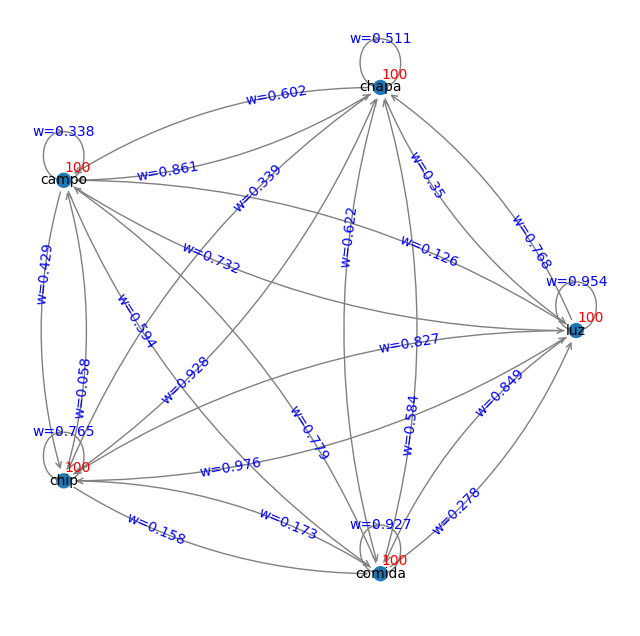

In [ ]:
g_test_random = armar_grafo(test_random, precios_random=False)
plot(g_test_random, grande=False, labels=True)

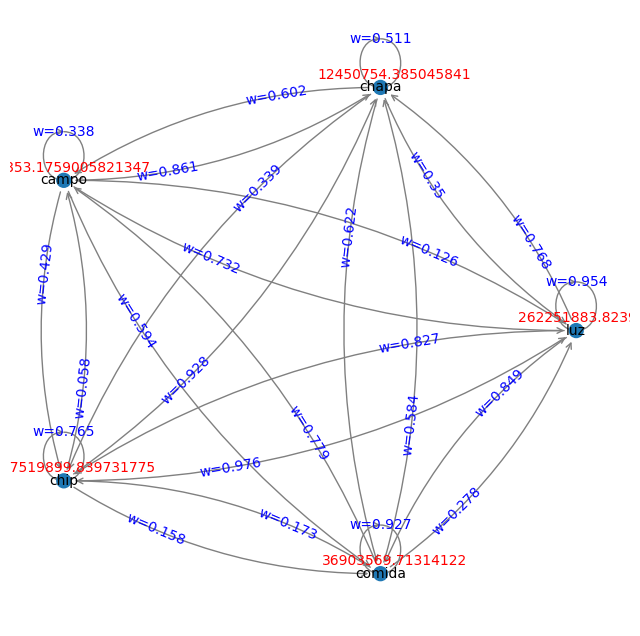

In [ ]:
t=0
log=""
shock('luz',80,g_test_random, limite=2000)
plot(g_test_random, grande=False, labels=True)

In [ ]:
print(log[9000:10000])

n 0.043836417309234633% a luz. 
Paso nº 162. 
 Aumentando un 0.041826565925508936% a luz. 
Paso nº 163. 
 Aumentando un 0.03990886401093735% a luz. 
Paso nº 164. 
 Aumentando un 0.038079086613996525% a luz. 
Paso nº 165. 
 Aumentando un 0.03633320249253049% a luz. 
Paso nº 166. 
 Aumentando un 0.03466736523238982% a luz. 
Paso nº 167. 
 Aumentando un 0.0330779047732714% a luz. 
Paso nº 168. 
 Aumentando un 0.03156131932308906% a luz. 
Paso nº 169. 
 Aumentando un 0.030114267643061455% a luz. 
Paso nº 170. 
 Aumentando un 0.028733561686520092% a luz. 
Paso nº 171. 
 Aumentando un 0.02741615957521994% a luz. 
Paso nº 172. 
 Aumentando un 0.02615915889767843% a luz. 
Paso nº 173. 
 Aumentando un 0.02495979031477821% a luz. 
Paso nº 174. 
 Aumentando un 0.023815411458545988% a luz. 
Paso nº 175. 
 Aumentando un 0.022723501110665616% a luz. 
Paso nº 176. 
 Aumentando un 0.021681653647899934% a luz. 
Paso nº 177. 
 Aumentando un 0.02068757374218389% a luz. 
Paso nº 178. 
 Aumentando un 0.019

Aún con un grafo conexo y pesos random, el aumento parece converger, pero amplificando exageradamente el aumento inicial. Parece ser que refuerza la hipótesis de inflación estructural.

## TODO:

Encontrar cómo visualizar el grafo del MIP y correr el shock en ese.
Implementar la inflación.

## proceso

Dejo asentado el proceso de creación del código. Esta sección no debe ser ejecutada nunca más. Para ver los resultados ver el informe que se encuentra inmediatamente arriba de este

In [ ]:
!pip install quantecon_book_networks

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import itertools as it
import pandas as pd

In [ ]:
mip = np.array([[0.09,0.59,0],[0.18,0,0.75],[0,0,0]])
G = nx.MultiDiGraph(mip)
mip

array([[0.09, 0.59, 0.  ],
       [0.18, 0.  , 0.75],
       [0.  , 0.  , 0.  ]])

Función sacada de la documentación de NetworkX

In [ ]:
def draw_labeled_multigraph(G, attr_name, ax=None):
    """
    Length of connectionstyle must be at least that of a maximum number of edges
    between pair of nodes. This number is maximum one-sided connections
    for directed graph and maximum total connections for undirected graph.
    """
    # Works with arc3 and angle3 connectionstyles
    connectionstyle = [f"arc3,rad={r}" for r in it.accumulate([0.15] * 4)]
    # connectionstyle = [f"angle3,angleA={r}" for r in it.accumulate([30] * 4)]

    pos = nx.shell_layout(G)
    nx.draw_networkx_nodes(G, pos, ax=ax)
    nx.draw_networkx_labels(G, pos, font_size=10, ax=ax)
    nx.draw_networkx_edges(
        G, pos, edge_color="grey", connectionstyle=connectionstyle, ax=ax
    )

    labels = {
        tuple(edge): f"{attr_name}={attrs[attr_name]}"
        for *edge, attrs in G.edges(keys=True, data=True)
    }
    nx.draw_networkx_edge_labels(
        G,
        pos,
        labels,
        connectionstyle=connectionstyle,
        label_pos=0.3,
        font_color="blue",
        bbox={"alpha": 0},
        ax=ax,
    )

Convierto los datos del nparray en un pd-dataframe para tener info de los sectores

In [ ]:
sectores = ['agr','mol','pan']
df = pd.DataFrame(data=mip,columns=sectores, index=sectores)
df

,agr,mol,pan
agr,0.09,0.59,0.00
mol,0.18,0.00,0.75
pan,0.00,0.00,0.00


In [ ]:
graph = {}
for index, row in df.iterrows():
  d = {}
  for (k, v) in row.items():
    d[k] = {"w":v}
  graph[index] = d

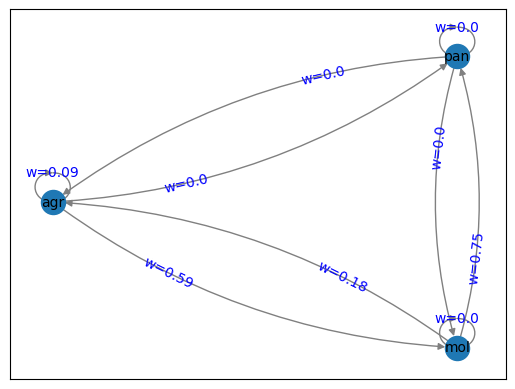

In [ ]:
G = nx.MultiDiGraph(graph)
draw_labeled_multigraph(G, "w")

Saco los edges que tienen peso = 0

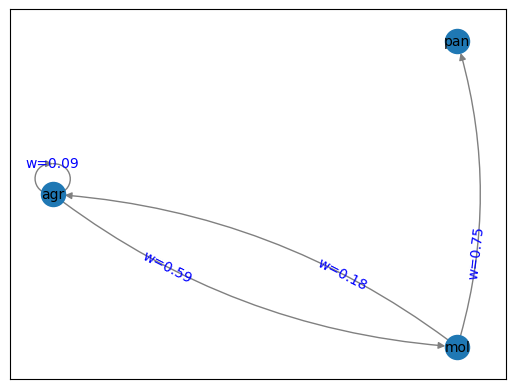

In [ ]:
G2 = nx.MultiDiGraph(graph)
for (n1,n2,d) in G.edges(data=True):
  if d['w'] == 0:
    G2.remove_edge(n1,n2)  # unpacks e from an edge tuple
draw_labeled_multigraph(G2, "w")

Voy a ver que pasa si hago esto mismo con la MIP del indec

In [ ]:
mip = pd.read_csv('/content/MIP Pandas', index_col='Unnamed: 0')

In [ ]:
mip

,"Cultivo de cereales, oleaginosas y forrajeras","Cultivo de hortalizas, legumbres, flores y plantas ornamentales",Cultivo de frutas y nueces,Cultivos industriales,Producción de semillas,"Cría de ganado y producción de leche, lana y pelos",Producción de granja,Servicios agropecuarios,Caza,Silvicultura y extracción de madera,...,Enseñanza pública,Enseñanza privada,Salud humana pública,Salud humana privada,Servicios veterinarios,Servicios sociales,Servicios de saneamiento,Actividad de asociaciones,"Servicios de cine, radio y televisión","Servicios personales, de reparación, actividades deportivas y de esparcimiento"
"Cultivo de cereales, oleaginosas y forrajeras",0.010319,0.000000,0.021804,0.005831,0.000000,0.152144,0.058182,0.000000,0.000000,0.000000,...,0.0,0.000699,0.0,0.000123,0.002589,0.0,0.000000,0.000000,7.665287e-09,3.667518e-03
"Cultivo de hortalizas, legumbres, flores y plantas ornamentales",0.000000,0.167226,0.013082,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.010121,0.0,0.002514,0.000000,0.0,0.000000,0.008649,5.289048e-07,8.638087e-03
Cultivo de frutas y nueces,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.004982,0.0,0.001217,0.000000,0.0,0.000000,0.000000,4.599172e-08,4.729049e-07
Cultivos industriales,0.000000,0.000000,0.000000,0.020212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000e+00,0.000000e+00
Producción de semillas,0.097189,0.021008,0.052329,0.007799,0.021740,0.013291,0.001349,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Servicios sociales,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000e+00,0.000000e+00
Servicios de saneamiento,0.000004,0.000009,0.000009,0.000004,0.000004,0.000004,0.000005,0.000004,0.000001,0.000006,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000e+00,0.000000e+00
Actividad de asociaciones,0.000277,0.000634,0.000573,0.000253,0.000273,0.000254,0.000418,0.000248,0.000073,0.000404,...,0.0,0.000000,0.0,0.125844,0.103975,0.0,0.000000,0.000000,1.514040e-03,0.000000e+00
"Servicios de cine, radio y televisión",0.000121,0.000248,0.000220,0.000100,0.000100,0.000108,0.000606,0.000090,0.000030,0.001565,...,0.0,0.009468,0.0,0.005010,0.008487,0.0,0.060125,0.048985,8.850829e-02,4.419621e-03


In [ ]:
graph = {}
for index, row in mip.iterrows():
  d = {}
  for (k, v) in row.items():
    d[k] = {"w":v}
  graph[index] = d


KeyboardInterrupt: 

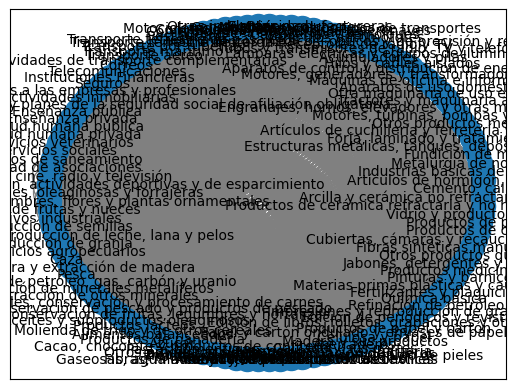

In [ ]:
G = nx.MultiDiGraph(graph)
draw_labeled_multigraph(G, "w")

No funciona esta forma de ver el grafo

In [ ]:
G2 = nx.MultiDiGraph(graph)
for (n1,n2,d) in G.edges(data=True):
  if d['w'] == 0:
    G2.remove_edge(n1,n2)

In [ ]:
dict(G2.degree)

{'Cultivo de cereales, oleaginosas y forrajeras': 102,
 'Cultivo de hortalizas, legumbres, flores y plantas ornamentales': 108,
 'Cultivo de frutas y nueces': 97,
 'Cultivos industriales': 91,
 'Producción de semillas': 81,
 'Cría de ganado y producción de leche, lana y pelos': 106,
 'Producción de granja': 104,
 'Servicios agropecuarios': 78,
 'Caza': 69,
 'Silvicultura y extracción de madera': 110,
 'Pesca': 95,
 'Extracción de petróleo, gas, carbón y uranio': 86,
 'Extracción de minerales metalíferos': 45,
 'Extracción de otros minerales': 88,
 'Matanza de animales, conservación y procesamiento de carnes': 98,
 'Elaboración y conservación de pescado y productos de pescado': 76,
 'Elaboración y conservación de frutas, legumbres y hortalizas': 91,
 'Aceites y subproductos oleaginosos': 94,
 'Productos lácteos': 89,
 'Molienda de trigo y de otros cereales': 89,
 'Alimentos balanceados': 87,
 'Productos de panadería': 97,
 'Azúcar': 91,
 'Cacao, chocolate y productos de confitería': 86,

In [ ]:
list(G2.degree())[0][1]

102

In [ ]:
def plot(G, labels=False, grande=True, node_data=False):
  connectionstyle = [f"arc3,rad={r}" for r in it.accumulate([0.15] * 4)]

  tamaños = list(G.degree())
  for i in range(len(tamaños)):
    tamaños[i] = (tamaños[i][1] ** 2) / 9 if ((tamaños[i][1] ** 2) / 9 ) > 100 else 100


  pos = nx.kamada_kawai_layout(G)
  if grande:
    fig, ax = plt.subplots(figsize=(30, 30))
  else:
    fig,ax = plt.subplots(figsize=(8,8))
  plt.axis("off")

  nx.draw_networkx_nodes(G, pos, node_size=tamaños, ax = ax)

  nx.draw_networkx_labels(G, pos, font_size=10, ax=ax)

  nx.draw_networkx_edges(
      G, pos, edge_color="grey", connectionstyle=connectionstyle, ax=ax, arrows=True, arrowstyle='->',
  )

  if labels:
    labels = {
        tuple(edge): f"{'w'}={round(attrs['w'],3)}"
        for *edge, attrs in G.edges(keys=True, data=True)
    }

    nx.draw_networkx_edge_labels(
        G,
        pos,
        labels,
        connectionstyle=connectionstyle,
        label_pos=0.3,
        font_color="blue",
        bbox={"alpha": 0},
        ax=ax,
    )

    labels = dict(G.nodes(data=True))
    for key in labels:
      labels[key] = labels[key]['precio']

    for key in pos:
      pos[key] = pos[key] + 0.05

    nx.draw_networkx_labels(
        G,
        pos,
        labels,
        font_size = 10,
        font_color="red",
        ax=ax,
    )

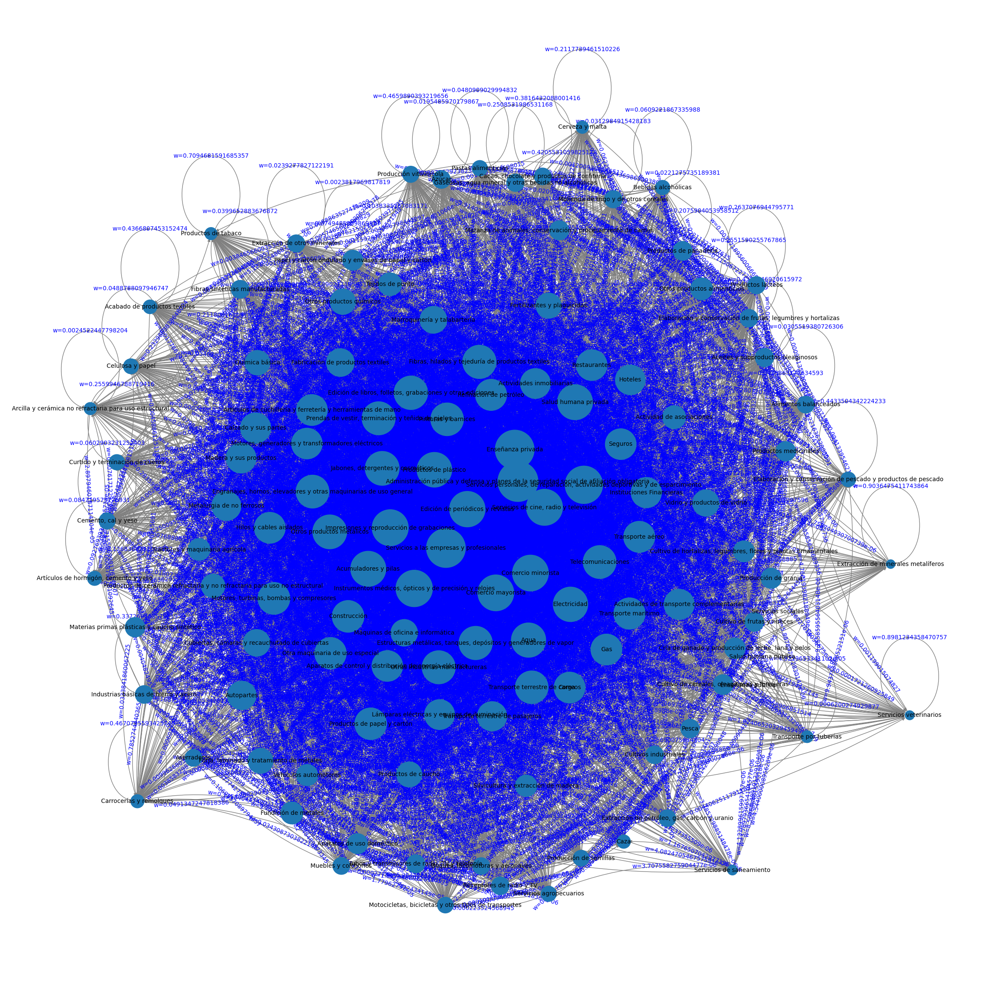

In [ ]:
plot(G2)

Truncando los pesos a solo 3 digitos.

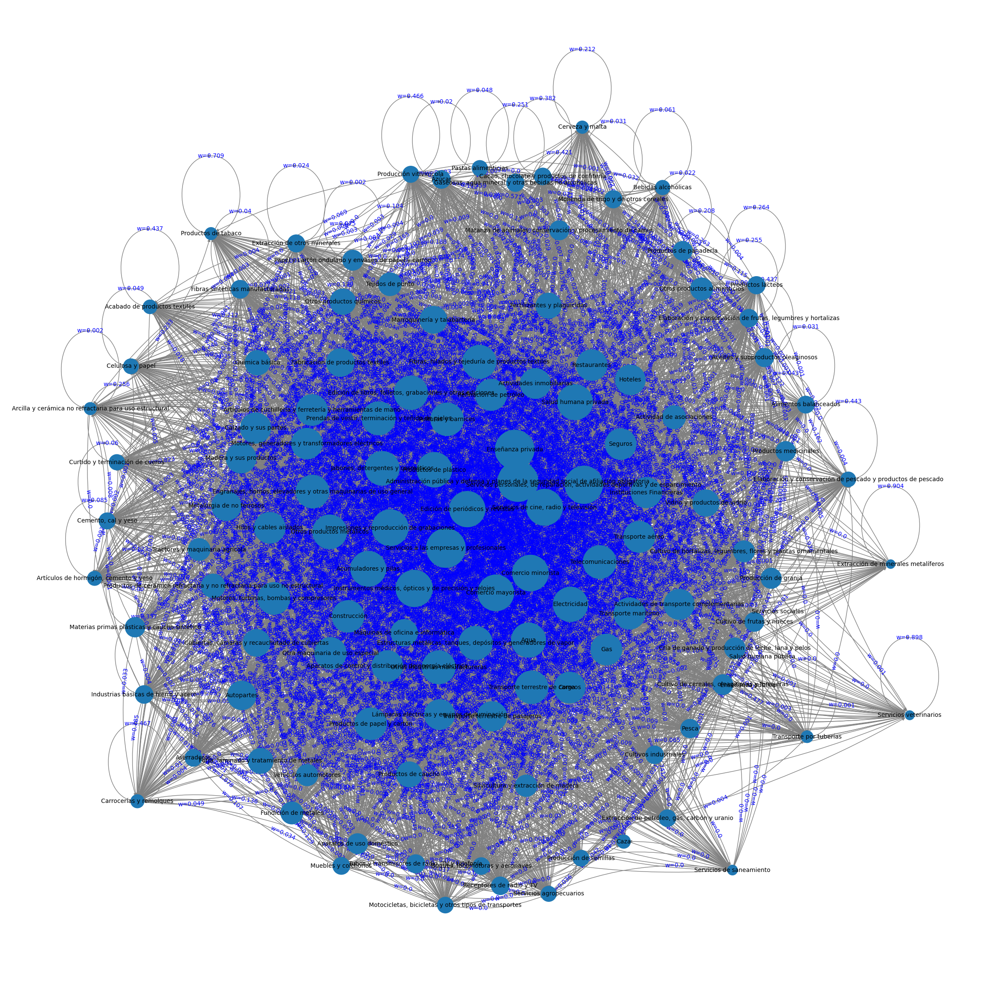

In [ ]:
plot(G2)

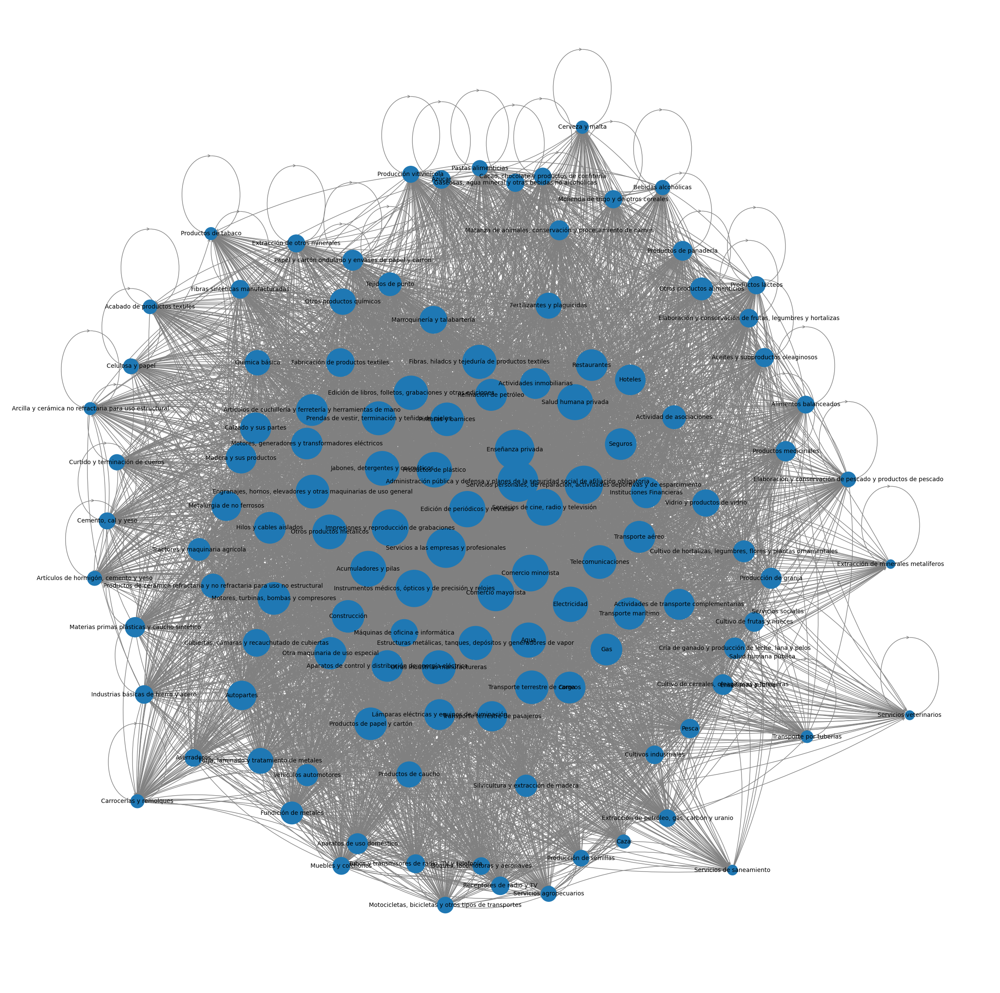

In [ ]:
plot(G2)

In [ ]:
G2['Extracción de minerales metalíferos']

AdjacencyView({'Extracción de minerales metalíferos': {0: {'w': 0.9036475411743864}}, 'Gaseosas, agua mineral y otras bebidas no alcohólicas': {0: {'w': 3.935642429957417e-05}}, 'Fertilizantes y plaguicidas': {0: {'w': 0.0004135578269364}}, 'Otros productos químicos': {0: {'w': 0.0003534026323577}}, 'Vidrio y productos de vidrio': {0: {'w': 8.758704030700739e-06}}, 'Cemento, cal y yeso': {0: {'w': 0.0015006585231506}}, 'Industrias básicas de hierro y acero': {0: {'w': 0.0002678621083838}}, 'Estructuras metálicas, tanques, depósitos y generadores de vapor': {0: {'w': 0.0005779433896885}}, 'Administración pública y defensa y planes de la seguridad social de afiliación obligatoria': {0: {'w': 6.051574610555714e-06}}})

Tengo que agregar el atributo de precio a los nodos
Documentación:


```
G = nx.path_graph(3)
attrs = {0: {"attr1": 20, "attr2": "nothing"}, 1: {"attr2": 3}}
nx.set_node_attributes(G, attrs)
G.nodes[0]["attr1"]
20
G.nodes[0]["attr2"]
'nothing'
G.nodes[1]["attr2"]
3
G.nodes[2]
{}
```



In [ ]:
nodos = list(G2.nodes())

In [ ]:
precios = {}
for nodo in nodos:
  precios[nodo] = {'precio': int(round(np.random.rand() * 1000, 0))}


In [ ]:
def setear_precios(G, precios):
  nx.set_node_attributes(G, precios)

In [ ]:
setear_precios(G2, precios)

In [ ]:
def shock(nodo, aumento, G, dinamica = 1, es_shock = True, un_paso=False, limite = 10): # aumento pasado en %.
  global t
  t = t + 1

  if t < limite:
    print(f'Paso nº {t}. \n Aumentando un {aumento}% a {nodo}.')
    # Actualizacion de precios. Dinamicas: 1 -> Aumenta según el aumento que le viene. 2 -> Segun inflación. 3 -> Promedio entre los dos.
    if es_shock: #Sólo hago el aumento acá si es el primer shock. Si no no, porque lo haría dos veces.
      precio_actual = G.nodes[nodo]['precio']
      # print('Precio viejo ', precio_actual)
      nuevo_precio = { nodo : { 'precio': (precio_actual * (1 + (aumento / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)
      # print(f'Precio nuevo con un {aumento}% de aumento: ', G.nodes[nodo]['precio'])


    # Actualización de pesos de los vecinos directos. Lo hago acá y no en un paso recursivo para asegurar que se actualizen todos los nodos
    # a k distancia antes de actualizar los de k+1.
    vecinos = G[nodo].items()
    aumentos_a_pasar = []
    for vecino in vecinos:
      nodo_vecino = vecino[0]
      peso_arista = vecino[1][0]['w']
      precio_actual = G.nodes[nodo_vecino]['precio']
      aumento_pasado = aumento * peso_arista
      # print('aumento',type(aumento), aumento)
      # print('peso_arista',type(peso_arista),peso_arista)
      # print('precio_actual',type(precio_actual),precio_actual)
      # print('aumento_pasado',type(aumento_pasado),aumento_pasado)
      nuevo_precio = {nodo_vecino : {'precio' : (precio_actual * (1 + (aumento_pasado / 100)))}}
      nx.set_node_attributes(G, nuevo_precio)
      aumentos_a_pasar.append(aumento_pasado)
    #ahora sigue la cadena de aumentos.
    if not un_paso:
      for i, vecino in enumerate(vecinos):
        shock(vecino[0], aumentos_a_pasar[i], G, es_shock = False, limite = limite)




In [ ]:
list(G2['Telecomunicaciones'].items())

[('Cultivo de cereales, oleaginosas y forrajeras',
  AtlasView({0: {'w': 0.0007301785648601}})),
 ('Cultivo de hortalizas, legumbres, flores y plantas ornamentales',
  AtlasView({0: {'w': 0.0016749070870796}})),
 ('Cultivo de frutas y nueces', AtlasView({0: {'w': 0.0015124514909}})),
 ('Cultivos industriales', AtlasView({0: {'w': 0.0006684930493665}})),
 ('Producción de semillas', AtlasView({0: {'w': 0.0007205141083121}})),
 ('Cría de ganado y producción de leche, lana y pelos',
  AtlasView({0: {'w': 0.0006693766655783}})),
 ('Producción de granja', AtlasView({0: {'w': 0.0013178011620176}})),
 ('Servicios agropecuarios', AtlasView({0: {'w': 0.0006549928076115}})),
 ('Caza', AtlasView({0: {'w': 0.000192370453533}})),
 ('Silvicultura y extracción de madera',
  AtlasView({0: {'w': 0.0010667669721501}})),
 ('Pesca', AtlasView({0: {'w': 0.0393297840200347}})),
 ('Extracción de petróleo, gas, carbón y uranio',
  AtlasView({0: {'w': 0.0053983572302873}})),
 ('Extracción de minerales metalífer

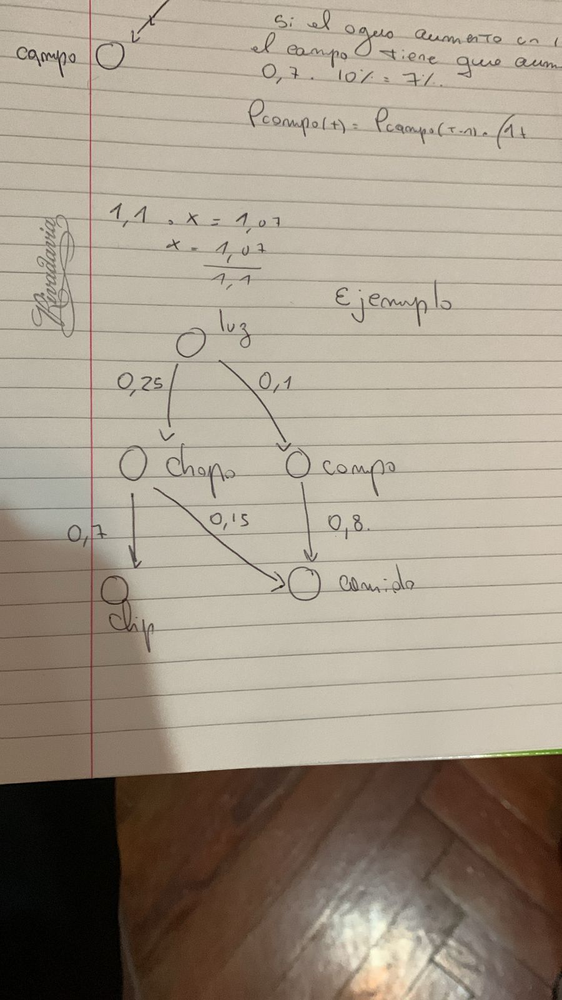

In [ ]:
sectores = ['luz','chapa','campo','chip','comida']
pesos = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0,0,0,0,0],[0,0,0,0,0]])
test = pd.DataFrame(data=pesos,columns=sectores,index=sectores)
test

,luz,chapa,campo,chip,comida
luz,0.0,0.25,0.1,0.0,0.00
chapa,0.0,0.00,0.0,0.7,0.15
campo,0.0,0.00,0.0,0.0,0.80
chip,0.0,0.00,0.0,0.0,0.00
comida,0.0,0.00,0.0,0.0,0.00


In [ ]:
def armar_grafo(dataframe, precios_random=True):
  graph = {}
  for index, row in dataframe.iterrows():
    d = {}
    for (k, v) in row.items():
      d[k] = {"w":v}
    graph[index] = d
  G_base = nx.MultiDiGraph(graph)
  G = nx.MultiDiGraph(graph)
  for (n1,n2,d) in G_base.edges(data=True):
    if d['w'] == 0:
      G.remove_edge(n1,n2)

  nodos = list(G.nodes())
  precios = {}
  for nodo in nodos:
    if precios_random:
      precios[nodo] = {'precio': int(round(np.random.rand() * 1000, 0))}
    else:
      precios[nodo] = {'precio': 100}
  setear_precios(G, precios)
  return G

In [ ]:
g_test = armar_grafo(test, precios_random=False)

In [ ]:
g_test.edges(data=True)

OutMultiEdgeDataView([('luz', 'chapa', {'w': 0.25}), ('luz', 'campo', {'w': 0.1}), ('chapa', 'chip', {'w': 0.7}), ('chapa', 'comida', {'w': 0.15}), ('campo', 'comida', {'w': 0.8})])

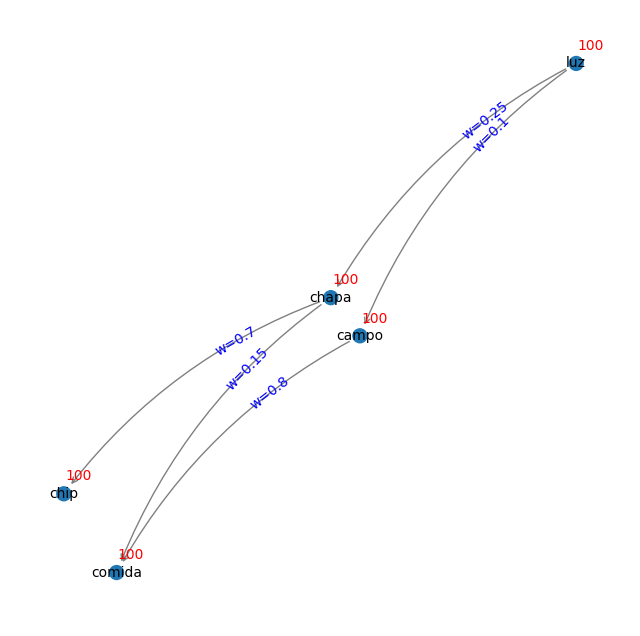

In [ ]:
g_test = armar_grafo(test, precios_random=False)
plot(g_test, grande=False, labels=True)

Paso nº 1. 
 Aumentando un 50% a luz.
Paso nº 2. 
 Aumentando un 12.5% a chapa.
Paso nº 3. 
 Aumentando un 8.75% a chip.
Paso nº 4. 
 Aumentando un 1.875% a comida.
Paso nº 5. 
 Aumentando un 5.0% a campo.
Paso nº 6. 
 Aumentando un 4.0% a comida.


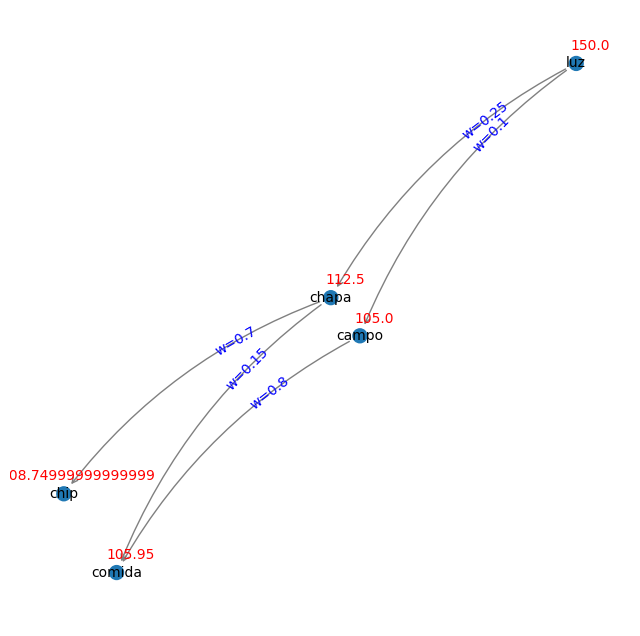

In [ ]:
t=0
shock('luz', 50, g_test)
plot(g_test,grande=False,labels=True)

Voy a agregarle una arits de Chip a luz, a ver cómo se comporta con los ciclos.

In [ ]:
pesos_ciclo = np.array([[0,0.25,0.1,0,0],[0,0,0,0.7,0.15],[0,0,0,0,0.8],[0.2,0,0,0,0],[0,0,0,0,0]])
test_ciclo = pd.DataFrame(data=pesos_ciclo,columns=sectores,index=sectores)
test_ciclo

,luz,chapa,campo,chip,comida
luz,0.0,0.25,0.1,0.0,0.00
chapa,0.0,0.00,0.0,0.7,0.15
campo,0.0,0.00,0.0,0.0,0.80
chip,0.2,0.00,0.0,0.0,0.00
comida,0.0,0.00,0.0,0.0,0.00


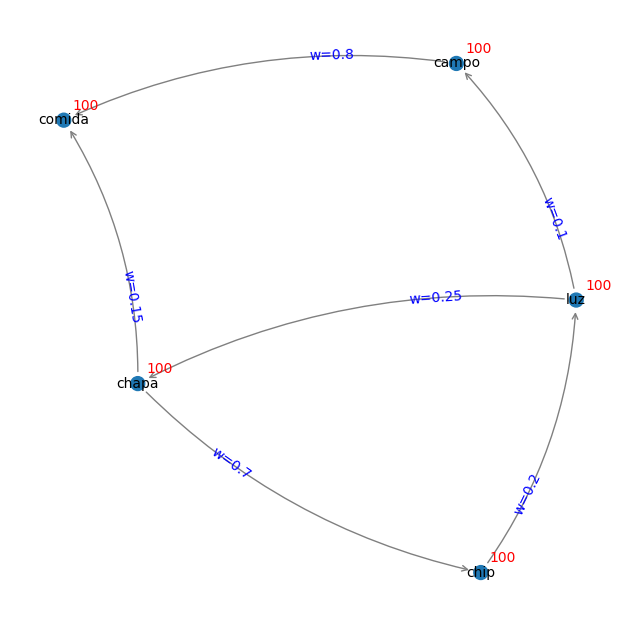

In [ ]:
g_test_ciclo = armar_grafo(test_ciclo, precios_random=False)
plot(g_test_ciclo, grande=False, labels=True)

In [ ]:
import sys
print(sys.getrecursionlimit())

1000


In [ ]:
sys.setrecursionlimit(1000)

NameError: name 'sys' is not defined

Paso nº 1. 
 Aumentando un 50% a luz.
Paso nº 2. 
 Aumentando un 12.5% a chapa.
Paso nº 3. 
 Aumentando un 8.75% a chip.
Paso nº 4. 
 Aumentando un 1.75% a luz.
Paso nº 5. 
 Aumentando un 0.4375% a chapa.
Paso nº 6. 
 Aumentando un 0.30624999999999997% a chip.
Paso nº 7. 
 Aumentando un 0.06125% a luz.
Paso nº 8. 
 Aumentando un 0.0153125% a chapa.
Paso nº 9. 
 Aumentando un 0.010718749999999999% a chip.
Paso nº 10. 
 Aumentando un 0.00214375% a luz.
Paso nº 11. 
 Aumentando un 0.0005359375% a chapa.
Paso nº 12. 
 Aumentando un 0.00037515624999999995% a chip.
Paso nº 13. 
 Aumentando un 7.503125e-05% a luz.
Paso nº 14. 
 Aumentando un 1.87578125e-05% a chapa.
Paso nº 15. 
 Aumentando un 1.3130468749999999e-05% a chip.
Paso nº 16. 
 Aumentando un 2.6260937499999997e-06% a luz.
Paso nº 17. 
 Aumentando un 6.565234374999999e-07% a chapa.
Paso nº 18. 
 Aumentando un 4.5956640624999994e-07% a chip.
Paso nº 19. 
 Aumentando un 9.191328125e-08% a luz.
Paso nº 20. 
 Aumentando un 2.29783203125

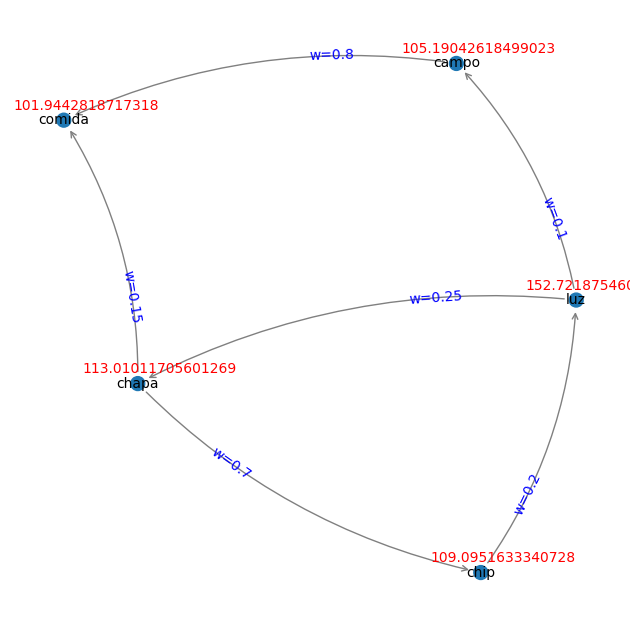

In [ ]:
t=0
shock('luz',50,g_test_ciclo, limite=50)
plot(g_test_ciclo, grande=False, labels=True)